# Load libraries

In [54]:
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [55]:
import numpy as np
import numba as nb
import pandas as pd
import scipy as sp
from scipy.integrate import solve_ivp
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns
import mpmath as mp
from functools import partial
from scipy.signal import find_peaks
import nolds

# Next Generation model with dynamic synapsis

In [56]:
from NextGenDynSyn import NextGenDynSyn

In [158]:
t0 = 0
tf = 1000
x0 = np.zeros(6)#solution#np.zeros(6)#np.array([-2.5,-4.5,1,-1,0,1])
h = 0.001
N = int((tf-t0)/h)
Nvariables = 6
time = np.arange(t0,tf,h)
params = dict(tau_e = 8,
              tau_i = 8,
              tau_se=1,
              tau_si=5,
              nu_e = -5,
              nu_i = -5,
              Delta_e = 1,
              Delta_i = 1,
              Jee = 5,
              Jei = 13,
              Jii = 5,
              Jie = 13,
              Iext_e=8,
              Iext_i=0,
              eps = 9)

In [171]:
sol = solve_ivp(NextGenDynSyn, [t0,tf], x0, method='RK45', rtol=1e-6, atol=1e-9,args=(Nvariables,params))
sol = solve_ivp(NextGenDynSyn, [t0,28], sol.y[:,len(sol.t)-1], method='RK45', rtol=1e-6, atol=1e-9,args=(Nvariables,params))

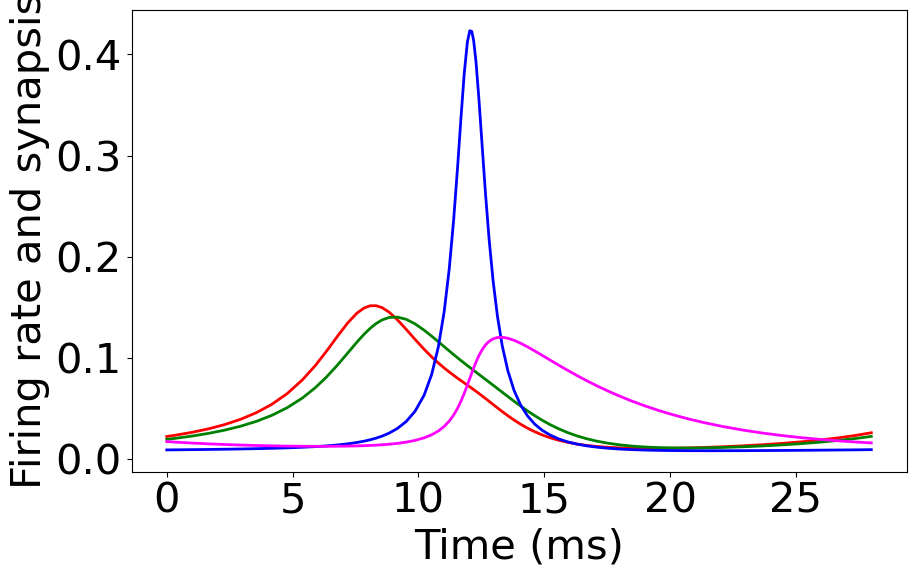

In [172]:
fig1=plt.figure(figsize=(10,6))
ax=plt.axes()
plt.plot(sol.t,sol.y[0,:],color='red',linewidth=2,label='r_e')
#plt.plot(sol.t,sol.y[1,:]/10,color='yellow',linewidth=2,label='v_e')
plt.plot(sol.t,sol.y[2,:],color='green',linewidth=2,label='s_e')
plt.plot(sol.t,sol.y[3,:],color='blue',linewidth=2,label='r_i')
#plt.plot(sol.t,sol.y[4,:]/10,color='orange',linewidth=2,label='v_i')
plt.plot(sol.t,sol.y[5,:],color='magenta',linewidth=2,label='s_i')
plt.xlabel("Time (ms)",fontsize=30)
plt.ylabel("Firing rate and synapsis",fontsize=30)
plt.xticks(fontsize=30)#,rotation=45)
plt.yticks(fontsize=30)
#ax.legend(loc="upper right",fontsize=30,ncol=2)
plt.show()
plt.close()

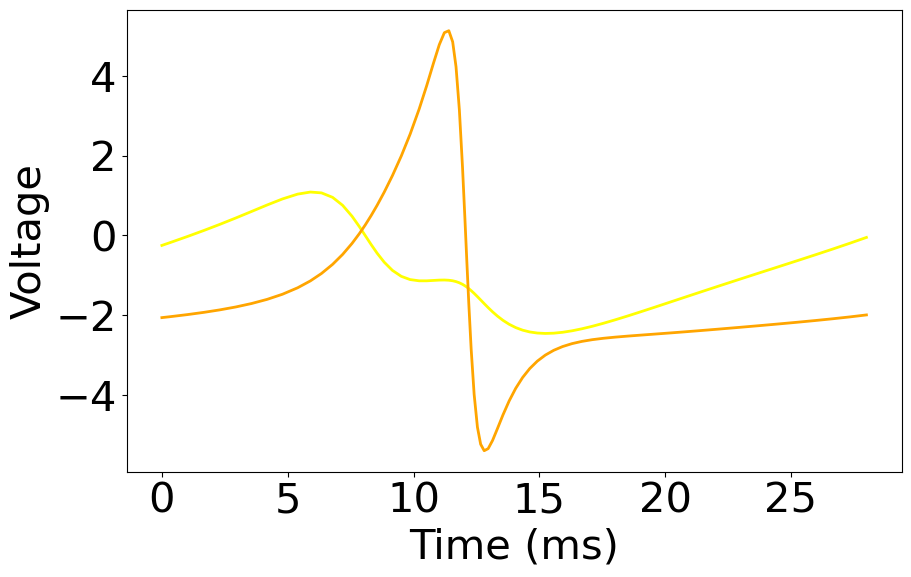

In [173]:
fig1=plt.figure(figsize=(10,6))
ax=plt.axes()
#plt.plot(sol.t,sol.y[0,:],color='red',linewidth=2,label='r_e')
plt.plot(sol.t,sol.y[1,:],color='yellow',linewidth=2,label='v_e')
#plt.plot(sol.t,sol.y[2,:],color='green',linewidth=2,label='s_e')
#plt.plot(sol.t,sol.y[3,:],color='blue',linewidth=2,label='r_i')
plt.plot(sol.t,sol.y[4,:],color='orange',linewidth=2,label='v_i')
#plt.plot(sol.t,sol.y[5,:],color='magenta',linewidth=2,label='s_i')
plt.xlabel("Time (ms)",fontsize=30)
plt.ylabel("Voltage",fontsize=30)
plt.xticks(fontsize=30)#,rotation=45)
plt.yticks(fontsize=30)
#ax.legend(loc="upper right",fontsize=30,ncol=2)
plt.show()
plt.close()

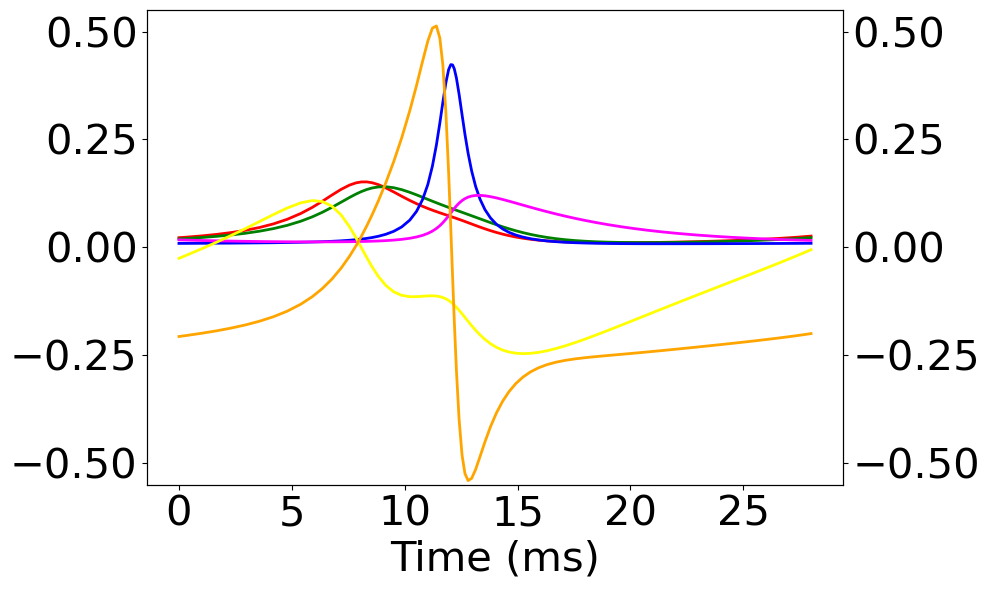

In [174]:
import matplotlib.pyplot as plt

fig1, ax1 = plt.subplots(figsize=(10,6))

# Primary axis
ax1.plot(sol.t, sol.y[0, :], color='red', linewidth=2, label='r_e')
ax1.plot(sol.t, sol.y[2, :], color='green', linewidth=2, label='s_e')
ax1.plot(sol.t, sol.y[3, :], color='blue', linewidth=2, label='r_i')
ax1.plot(sol.t, sol.y[5, :], color='magenta', linewidth=2, label='s_i')

ax1.set_xlabel("Time (ms)", fontsize=30)
#ax1.set_ylabel("Firing rate and synaptic variables", fontsize=30)
ax1.tick_params(axis='both', labelsize=30)

# Secondary y-axis for voltages
ax2 = ax1.twinx()
ax2.plot(sol.t, sol.y[1, :]/10, color='yellow', linewidth=2, label='v_e')
ax2.plot(sol.t, sol.y[4, :]/10, color='orange', linewidth=2, label='v_i')
#ax2.set_ylabel("Membrane potentials", fontsize=30)
ax2.tick_params(axis='y', labelsize=30)

# Combine legends from both axes
lines1, labels1 = ax1.get_legend_handles_labels()
lines2, labels2 = ax2.get_legend_handles_labels()
#ax1.legend(lines1 + lines2, labels1 + labels2, loc="upper right", fontsize=20)

ax1.set_ylim(-0.55, 0.55)         # Assuming firing rates/synaptic variables range from 0 to 1
ax2.set_ylim(-0.55, 0.55) 

ax1.set_xticks([0, 5, 10, 15, 20, 25]) 

plt.tight_layout()
plt.show()


In [ ]:
fig2=plt.figure(figsize=(20,8))
ax=plt.axes()
#plt.plot(sol.t,sol.y[0,:],color='red',linewidth=6,label='r_e')
plt.plot(sol.t,sol.y[1,:],color='yellow',linewidth=6,label='v_e')
#plt.plot(sol.t,sol.y[2,:],color='green',linewidth=6,label='s_e')
#plt.plot(sol.t,sol.y[3,:],color='blue',linewidth=6,label='r_i')
plt.plot(sol.t,sol.y[4,:],color='orange',linewidth=6,label='v_i')
#plt.plot(sol.t,sol.y[5,:],color='magenta',linewidth=6,label='s_i')
plt.xlabel("Time (ms)",fontsize=40)
plt.ylabel("Voltage",fontsize=40)
plt.xticks(fontsize=40)#,rotation=45)
plt.yticks(fontsize=40)
ax.legend(loc="upper right",fontsize=30,ncol=2)
plt.show()
plt.close()

In [ ]:
fig3=plt.figure(figsize=(20,8))
ax=plt.axes()
#plt.plot(sol.t,sol.y[0,:],color='red',linewidth=6,label='r_e')
#plt.plot(sol.t,sol.y[1,:],color='yellow',linewidth=6,label='v_e')
plt.plot(sol.t,sol.y[2,:],color='green',linewidth=6,label='s_e')
#plt.plot(sol.t,sol.y[3,:],color='blue',linewidth=6,label='r_i')
#plt.plot(sol.t,sol.y[4,:],color='orange',linewidth=6,label='v_i')
plt.plot(sol.t,sol.y[5,:],color='magenta',linewidth=6,label='s_i')
plt.xlabel("Time (ms)",fontsize=40)
plt.ylabel("Voltage",fontsize=40)
plt.xticks(fontsize=40)#,rotation=45)
plt.yticks(fontsize=40)
ax.legend(loc="upper right",fontsize=30,ncol=2)
plt.show()
plt.close()

# Homogeneous system Next Generation with dynamic synapsis

In [3]:
from HomogeneousSystem import HomogeneousSystem
from matplotlib.transforms import Bbox

In [15]:
#Initial and final times of integration
t0 = 0
tf = 1000
#Discretization used for integration
h = 0.01
#Number of points to evaluate the time integration
N = int((tf-t0)/h)
time_eval = np.linspace(t0, tf, N)
#Initial condition
x0 = np.zeros(6)#solution#np.zeros(6)#np.array([-2.5,-4.5,1,-1,0,1])

Nvariables = 6
time = np.arange(t0,tf,h)
params = dict(tau_e = 8,
              tau_i = 8,
              tau_se=1,
              tau_si=5,
              nu_e = -5,
              nu_i = -5,
              Delta_e = 1,
              Delta_i = 1,
              Jee = 5,
              Jei = 13,
              Jii = 5,
              Jie = 13,
              Iext_i=0,
              Iext_e=10.5,
              eps=12)
#PROBLEM: Iext_e=8,eps=15

In [16]:
sol = solve_ivp(HomogeneousSystem, [t0,tf], x0,t_eval=time_eval, method='RK45', rtol=1e-6, atol=1e-9,args=(Nvariables,params))

In [131]:
len(sol.t)

1000000

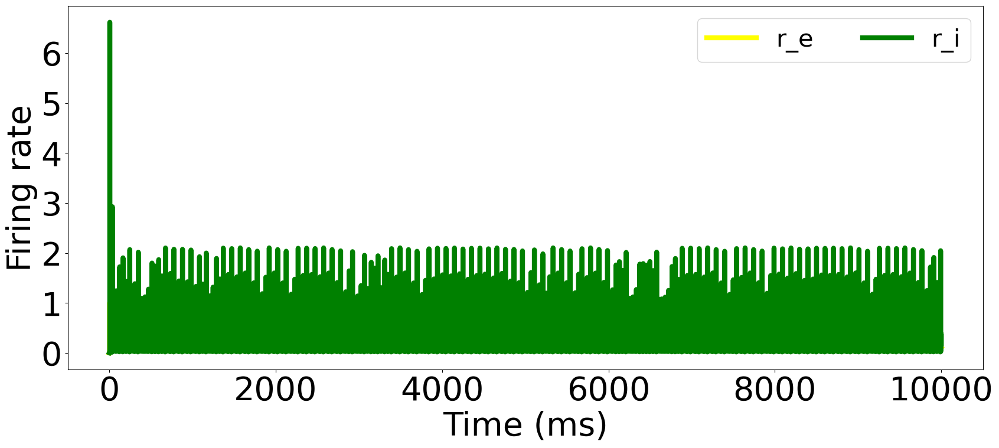

In [10]:
fig1=plt.figure(figsize=(20,8))
ax=plt.axes()

#plt.plot(sol.t[len(sol.t)-100000:len(sol.t)],sol.y[3,len(sol.t)-100000:len(sol.t)],color='blue',linewidth=6,label='r_i')
#plt.plot(sol.t[len(sol.t)-100000:len(sol.t)],sol.y[0,len(sol.t)-100000:len(sol.t)],color='red',linewidth=6,label='r_e')
plt.plot(sol.t,sol.y[0,:],color='yellow',linewidth=6,label='r_e')
plt.plot(sol.t,sol.y[3,:],color='green',linewidth=6,label='r_i')

#plt.plot(sol.t,sol.y[4,:],color='orange',linewidth=6,label='v_i')
#plt.plot(sol.t,sol.y[5,:],color='magenta',linewidth=6,label='s_i')
plt.xlabel("Time (ms)",fontsize=40)
plt.ylabel("Firing rate",fontsize=40)
plt.xticks(fontsize=40)#,rotation=45)
plt.yticks(fontsize=40)
ax.legend(loc="upper right",fontsize=30,ncol=2)
#plt.savefig('ComparisonModels/eps'+str(params['eps'])+'Iext_e__'+str(params['Iext_e'])+'.png')#,dpi=500,bbox_inches=Bbox([[0,-1],fig2.get_size_inches()]))
plt.show()
plt.close()

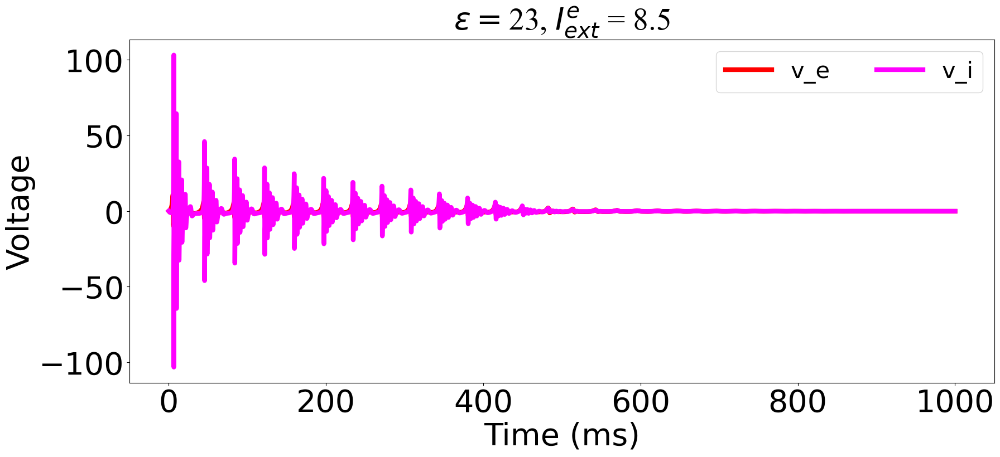

In [133]:
fig2=plt.figure(figsize=(20,8))
ax=plt.axes()
plt.plot(sol.t,sol.y[1,:],color='red',linewidth=6,label='v_e')
#plt.plot(sol.t[len(sol.t)-100000:len(sol.t)],sol.y[1,len(sol.t)-100000:len(sol.t)],color='green',linewidth=6,label='v_e')
#plt.plot(sol.t,sol.y[2,:],color='green',linewidth=6,label='s_e')
#plt.plot(sol.t,sol.y[3,:],color='blue',linewidth=6,label='r_i')
#plt.plot(sol.t[len(sol.t)-100000:len(sol.t)],sol.y[4,len(sol.t)-100000:len(sol.t)],color='orange',linewidth=6,label='v_i')
plt.plot(sol.t,sol.y[4,:],color='magenta',linewidth=6,label='v_i')
#plt.scatter(sol.t[peaks],sol.y[1,peaks],color='black')
plt.xlabel("Time (ms)",fontsize=40)
plt.ylabel("Voltage",fontsize=40)
plt.xticks(fontsize=40)#,rotation=45)
plt.yticks(fontsize=40)
ax.legend(loc="upper right",fontsize=30,ncol=2)
plt.title(r'$\epsilon=$'+str(params['eps'])+r', $I_{ext}^e$ = '+str(params['Iext_e']),fontsize=40,fontname='Times New Roman')
plt.savefig('ComparisonModels/Voltage_eps'+str(params['eps'])+'Iext_e__'+str(params['Iext_e'])+'.png',bbox_inches=Bbox([[0,-1],fig2.get_size_inches()]))
#plt.ylim([-5,5])
plt.show()
plt.close()

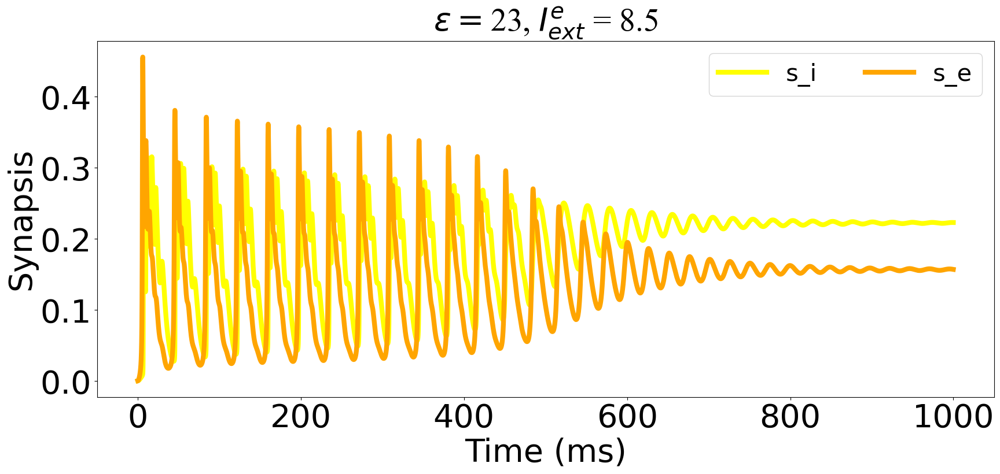

In [134]:
fig3=plt.figure(figsize=(20,8))
ax=plt.axes()
#plt.plot(sol.t,sol.y[0,:],color='red',linewidth=6,label='r_e')
plt.plot(sol.t,sol.y[5,:],color='yellow',linewidth=6,label='s_i')
#plt.plot(sol.t[len(sol.t)-100000:len(sol.t)],sol.y[2,len(sol.t)-100000:len(sol.t)],color='green',linewidth=6,label='s_e')
#plt.plot(sol.t,sol.y[3,:],color='blue',linewidth=6,label='r_i')
plt.plot(sol.t,sol.y[2,:],color='orange',linewidth=6,label='s_e')
#plt.plot(sol.t[len(sol.t)-100000:len(sol.t)],sol.y[5,len(sol.t)-100000:len(sol.t)],color='magenta',linewidth=6,label='s_i')
plt.xlabel("Time (ms)",fontsize=40)
plt.ylabel("Synapsis",fontsize=40)
plt.xticks(fontsize=40)#,rotation=45)
plt.yticks(fontsize=40)
ax.legend(loc="upper right",fontsize=30,ncol=2)
plt.title(r'$\epsilon=$'+str(params['eps'])+r', $I_{ext}^e$ = '+str(params['Iext_e']),fontsize=40,fontname='Times New Roman')
plt.savefig('ComparisonModels/Synapsis_eps'+str(params['eps'])+'Iext_e__'+str(params['Iext_e'])+'.png',bbox_inches=Bbox([[0,-1],fig2.get_size_inches()]))
plt.show()
plt.close()

# Chaotic dynamics

### Define Poincare section

In [4]:
# Define Poincare section
def PoincareEvent(t,x,Nvar,Params,alpha):
    return x[2]-alpha

# Event should be triggered when g(x) == 0 <=> x[1]=0
PoincareEvent.terminal = False  # Stop the integration when the event occurs
PoincareEvent.direction = 1    # Trigger when the second component crosses alpha in ascending direction

### Define parameters

In [137]:
params = dict(tau_e = 8,
              tau_i = 8,
              tau_se=1,
              tau_si=5,
              nu_e = -5,
              nu_i = -5,
              Delta_e = 1,
              Delta_i = 1,
              Jee = 5,
              Jei = 13,
              Jii = 5,
              Jie = 13,
              Iext_i=0,
              Iext_e=10.2,
              eps=14.5)

In [138]:
# 1. Initial integration to compute mean of s_e that we will use as Poincare section

#Initial and final times of integration
t0 = 0
tf = 1000
#Discretization used for integration
h = 0.001
#Number of points to evaluate the time integration
N = int((tf-t0)/h)
time_eval = np.linspace(t0, tf, N)
#Initial condition
x0 = np.zeros(6)
#Integrate
sol = solve_ivp(HomogeneousSystem, [t0,tf], x0,t_eval=time_eval, method='RK45', rtol=1e-6, atol=1e-9, args=(Nvariables,params))

# 2. Compute the mean s_e of the previous integration
idx_ms = 200
mean = np.mean(sol.y[2,len(sol.t)-int(idx_ms/h):len(sol.t)])
max = np.amax(sol.y[2,len(sol.t)-int(idx_ms/h):len(sol.t)])
#Update Poincare section with mean
PoincareEventAlpha = partial(PoincareEvent, alpha=mean)
PoincareEventAlpha.direction = 1  
tf = 500
#Number of points to evaluate the time integration
N = int((tf-t0)/h)
time_eval = np.linspace(t0, tf, N)
# 2a. Integrate Homogeneous state along tf time with poincare events
sol = solve_ivp(HomogeneousSystem, [t0,tf], sol.y[:,-1],t_eval=time_eval, method='RK45', rtol=1e-6, atol=1e-9,events = PoincareEventAlpha, args=(Nvariables,params))


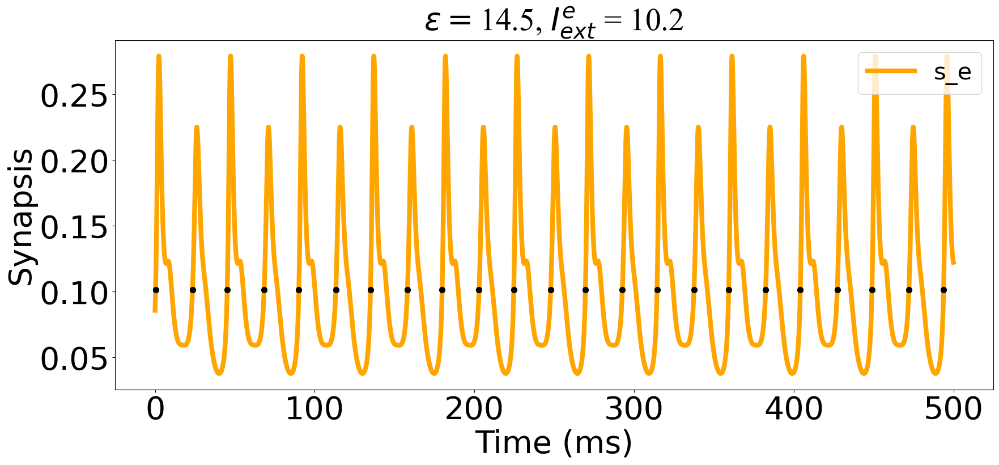

In [139]:
fig1=plt.figure(figsize=(20,8))
ax=plt.axes()
#plt.plot(sol.t,sol.y[5,:],color='yellow',linewidth=6,label='s_i')
plt.plot(sol.t,sol.y[2,:],color='orange',linewidth=6,label='s_e',zorder=1)
plt.scatter(sol.t_events[0],sol.y_events[0][:,2],s=50,color='black',zorder=2)
plt.xlabel("Time (ms)",fontsize=40)
plt.ylabel("Synapsis",fontsize=40)
plt.xticks(fontsize=40)#,rotation=45)
plt.yticks(fontsize=40)
ax.legend(loc="upper right",fontsize=30,ncol=2)
plt.title(r'$\epsilon=$'+str(params['eps'])+r', $I_{ext}^e$ = '+str(params['Iext_e']),fontsize=40,fontname='Times New Roman')
#plt.savefig('ComparisonModels/Synapsis_eps'+str(params['eps'])+'Iext_e__'+str(params['Iext_e'])+'.png',bbox_inches=Bbox([[0,-1],fig2.get_size_inches()]))
plt.show()
plt.close()

In [140]:
mean

np.float64(0.10118208332081571)

In [141]:
peaks,_ = find_peaks(sol.y[2,:])#,height=mean+0.01*max)

In [142]:
peaks.shape

(34,)

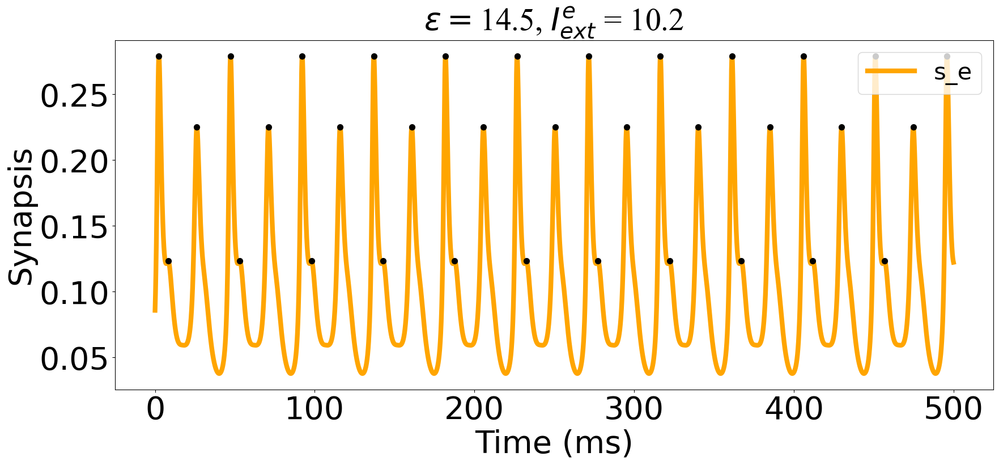

In [143]:
fig2=plt.figure(figsize=(20,8))
ax=plt.axes()
#plt.plot(sol.t,sol.y[5,:],color='yellow',linewidth=6,label='s_i')
plt.plot(sol.t,sol.y[2,:],color='orange',linewidth=6,label='s_e',zorder=1)
plt.scatter(sol.t[peaks],sol.y[2,peaks],s=50,color='black',zorder=2)
plt.xlabel("Time (ms)",fontsize=40)
plt.ylabel("Synapsis",fontsize=40)
plt.xticks(fontsize=40)#,rotation=45)
plt.yticks(fontsize=40)
ax.legend(loc="upper right",fontsize=30,ncol=2)
plt.title(r'$\epsilon=$'+str(params['eps'])+r', $I_{ext}^e$ = '+str(params['Iext_e']),fontsize=40,fontname='Times New Roman')
plt.savefig('PeriodDoublings/Synapsis_eps'+str(params['eps'])+'Iext_e__'+str(params['Iext_e'])+'.png',bbox_inches=Bbox([[0,-1],fig2.get_size_inches()]))
plt.show()
plt.close()

In [3]:
from ChaoticDynamicsStudy import ChaoticMaxMin

In [7]:
Nvariables = 6

(810,)
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275

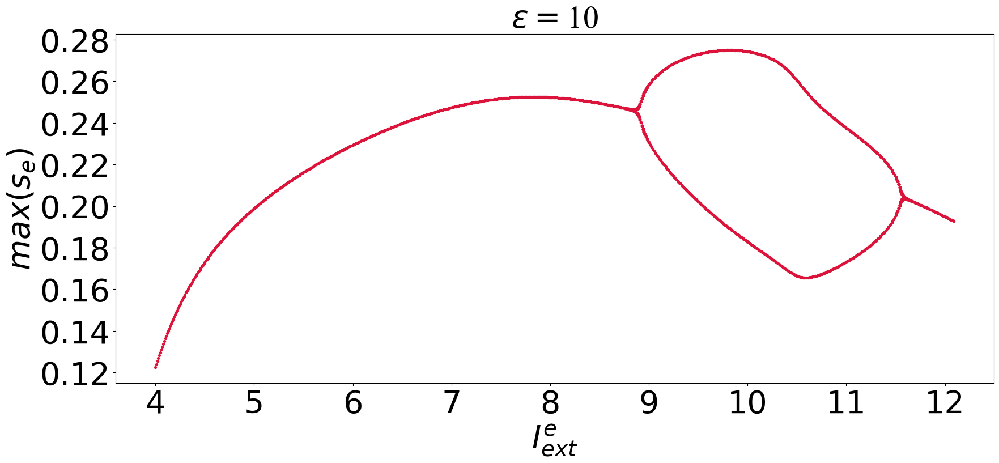

In [409]:

params = dict(tau_e = 8,
              tau_i = 8,
              tau_se=1,
              tau_si=5,
              nu_e = -5,
              nu_i = -5,
              Delta_e = 1,
              Delta_i = 1,
              Jee = 5,
              Jei = 13,
              Jii = 5,
              Jie = 13,
              Iext_i=0,
              eps=10)
save = True
padded_arrays,fig = ChaoticMaxMin(Nvariables,params,save)

(810,)
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275

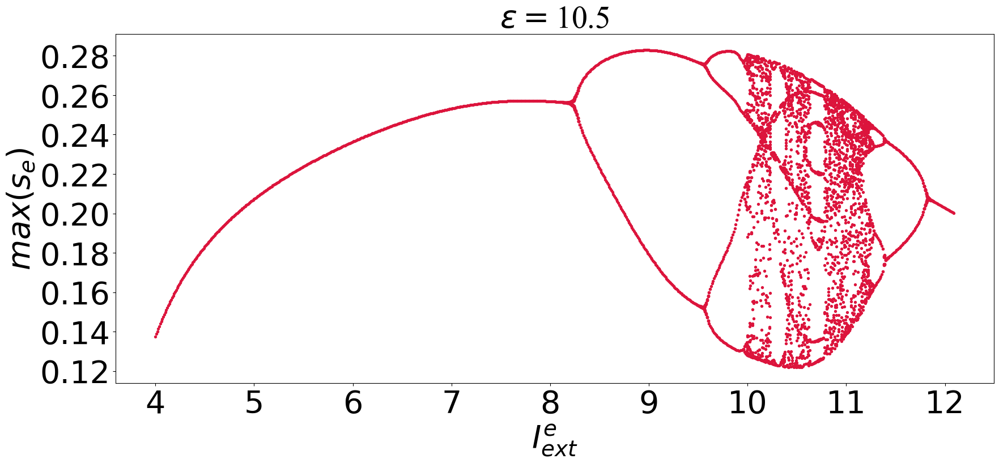

In [417]:
params = dict(tau_e = 8,
              tau_i = 8,
              tau_se=1,
              tau_si=5,
              nu_e = -5,
              nu_i = -5,
              Delta_e = 1,
              Delta_i = 1,
              Jee = 5,
              Jei = 13,
              Jii = 5,
              Jie = 13,
              Iext_i=0,
              eps=10.5)
save = True
padded_arrays,fig = ChaoticMaxMin(Nvariables,params,save)

(810,)
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275

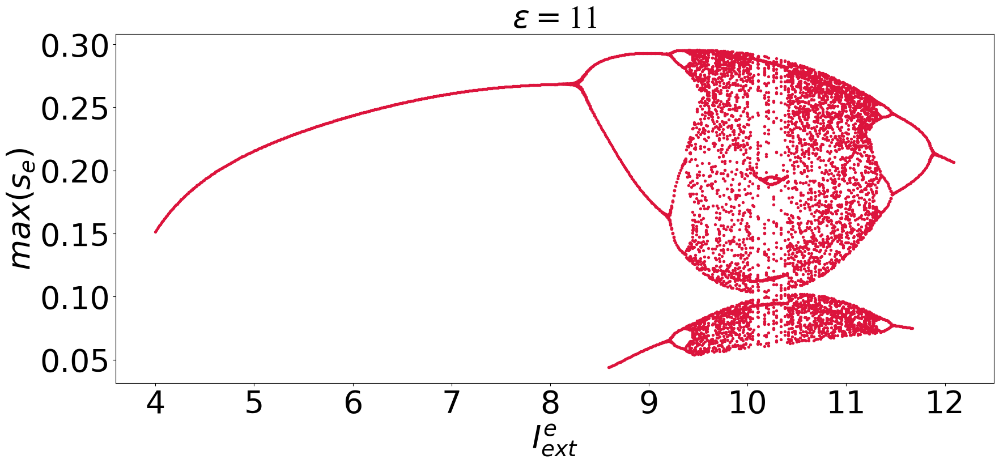

In [9]:
params = dict(tau_e = 8,
              tau_i = 8,
              tau_se=1,
              tau_si=5,
              nu_e = -5,
              nu_i = -5,
              Delta_e = 1,
              Delta_i = 1,
              Jee = 5,
              Jei = 13,
              Jii = 5,
              Jie = 13,
              Iext_i=0,
              eps=11)
save = True
padded_arrays,fig = ChaoticMaxMin(Nvariables,params,save)

(810,)
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275

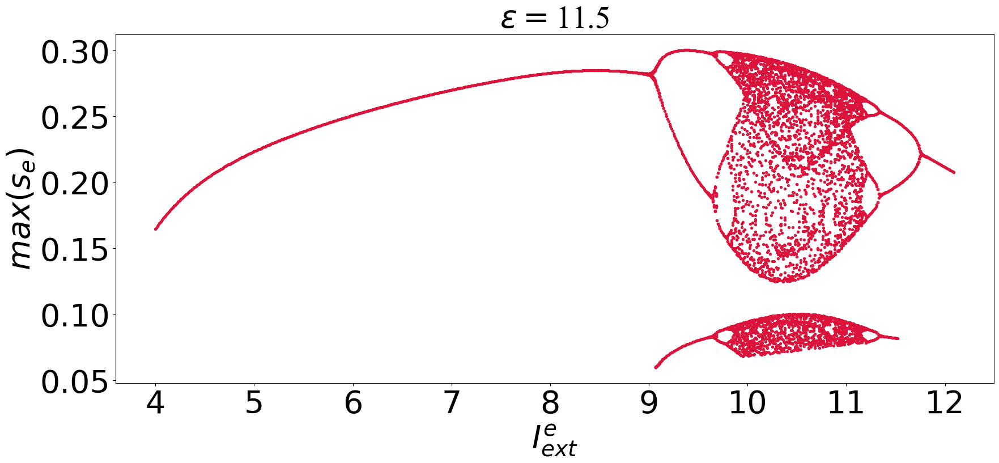

In [10]:
params = dict(tau_e = 8,
              tau_i = 8,
              tau_se=1,
              tau_si=5,
              nu_e = -5,
              nu_i = -5,
              Delta_e = 1,
              Delta_i = 1,
              Jee = 5,
              Jei = 13,
              Jii = 5,
              Jie = 13,
              Iext_i=0,
              eps=11.5)
save = True
padded_arrays,fig = ChaoticMaxMin(Nvariables,params,save)

(810,)
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275

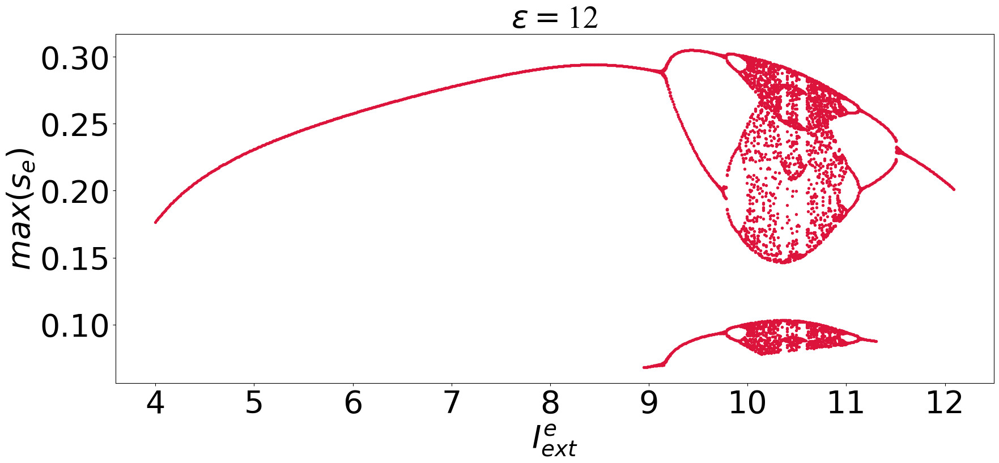

In [11]:
params = dict(tau_e = 8,
              tau_i = 8,
              tau_se=1,
              tau_si=5,
              nu_e = -5,
              nu_i = -5,
              Delta_e = 1,
              Delta_i = 1,
              Jee = 5,
              Jei = 13,
              Jii = 5,
              Jie = 13,
              Iext_i=0,
              eps=12)
save = True
padded_arrays,fig = ChaoticMaxMin(Nvariables,params,save)

(810,)
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275

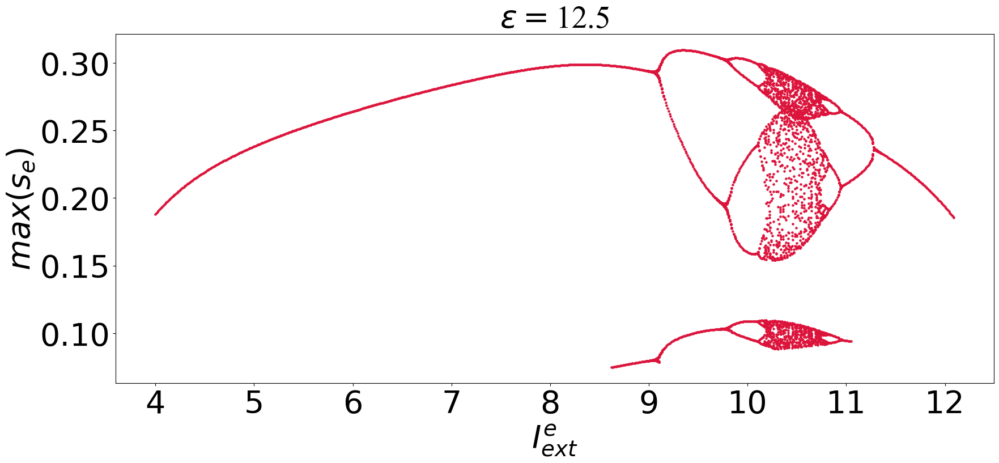

In [19]:
params = dict(tau_e = 8,
              tau_i = 8,
              tau_se=1,
              tau_si=5,
              nu_e = -5,
              nu_i = -5,
              Delta_e = 1,
              Delta_i = 1,
              Jee = 5,
              Jei = 13,
              Jii = 5,
              Jie = 13,
              Iext_i=0,
              eps=12.5)
save = True
padded_arrays,fig = ChaoticMaxMin(Nvariables,params,save)

(810,)
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275

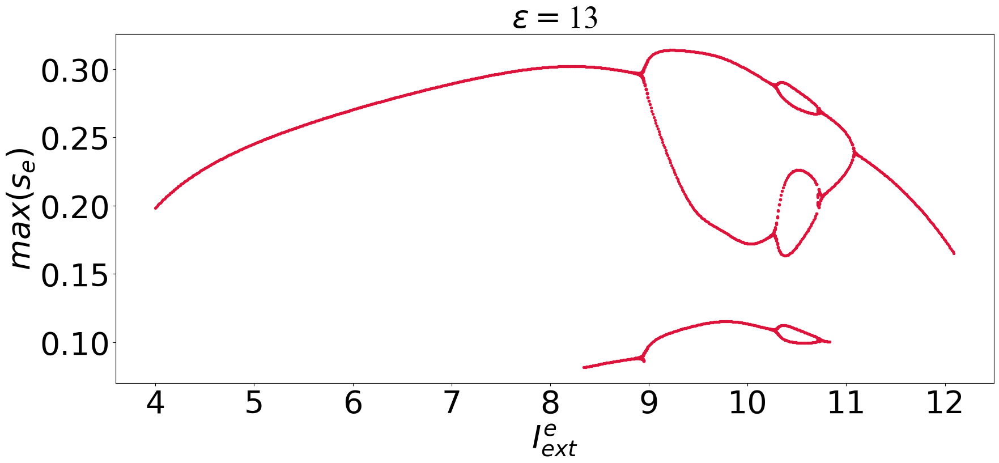

In [13]:
params = dict(tau_e = 8,
              tau_i = 8,
              tau_se=1,
              tau_si=5,
              nu_e = -5,
              nu_i = -5,
              Delta_e = 1,
              Delta_i = 1,
              Jee = 5,
              Jei = 13,
              Jii = 5,
              Jie = 13,
              Iext_i=0,
              eps=13)
save = True
padded_arrays,fig = ChaoticMaxMin(Nvariables,params,save)

(810,)
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275

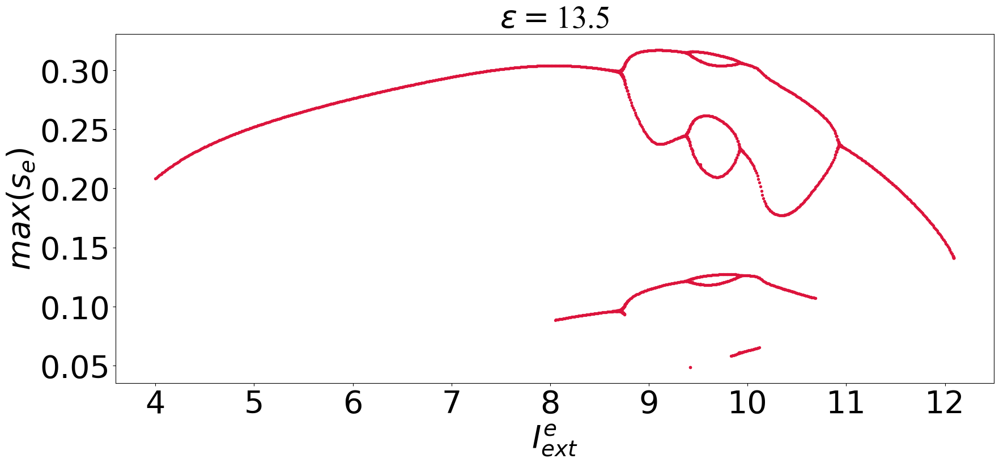

In [15]:
params = dict(tau_e = 8,
              tau_i = 8,
              tau_se=1,
              tau_si=5,
              nu_e = -5,
              nu_i = -5,
              Delta_e = 1,
              Delta_i = 1,
              Jee = 5,
              Jei = 13,
              Jii = 5,
              Jie = 13,
              Iext_i=0,
              eps=13.5)
save = True
padded_arrays,fig = ChaoticMaxMin(Nvariables,params,save)

(810,)
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275

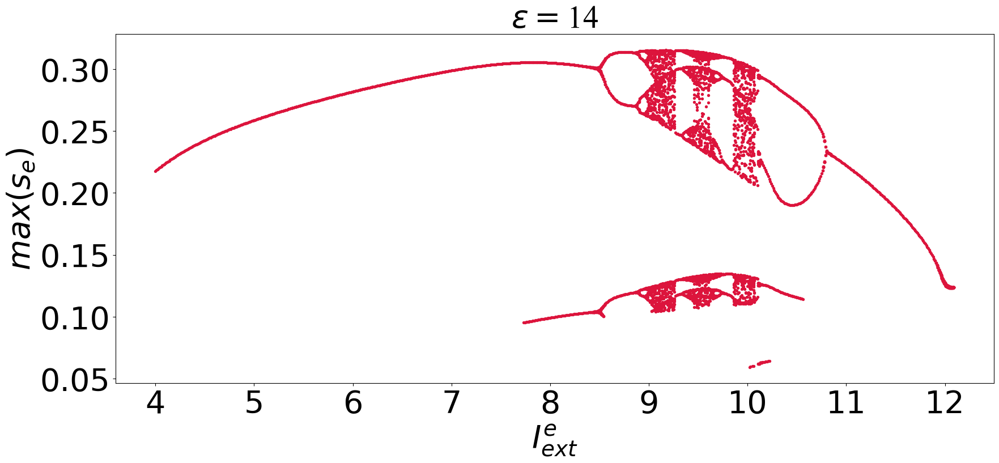

In [17]:
params = dict(tau_e = 8,
              tau_i = 8,
              tau_se=1,
              tau_si=5,
              nu_e = -5,
              nu_i = -5,
              Delta_e = 1,
              Delta_i = 1,
              Jee = 5,
              Jei = 13,
              Jii = 5,
              Jie = 13,
              Iext_i=0,
              eps=14)
save = True
padded_arrays,fig = ChaoticMaxMin(Nvariables,params,save)

(810,)
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275

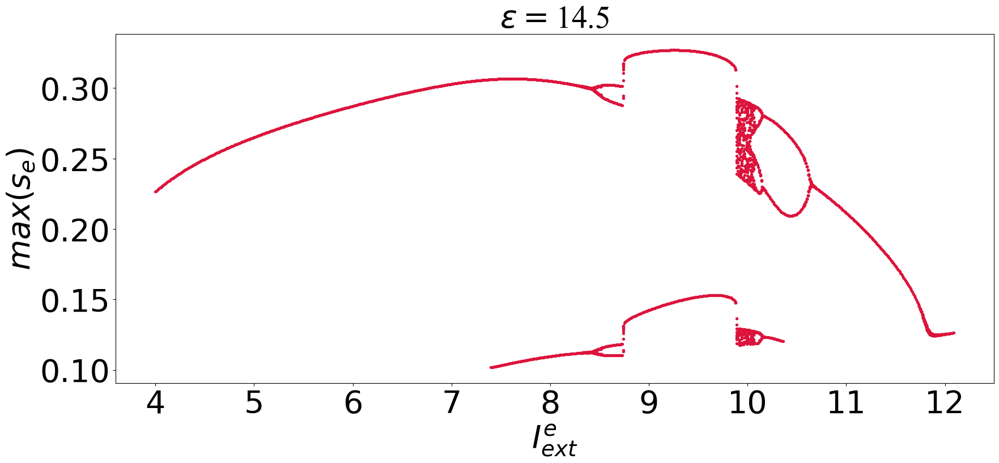

In [18]:
params = dict(tau_e = 8,
              tau_i = 8,
              tau_se=1,
              tau_si=5,
              nu_e = -5,
              nu_i = -5,
              Delta_e = 1,
              Delta_i = 1,
              Jee = 5,
              Jei = 13,
              Jii = 5,
              Jie = 13,
              Iext_i=0,
              eps=14.5)
save = True
padded_arrays,fig = ChaoticMaxMin(Nvariables,params,save)

# Lyapunov with Tomas Library

In [8]:
import Lyapunov
from DynamicalSystem import ContinuousDS
from HomogeneousSystemLyapunov import HomogeneousSystemLyapunov
from JacobianHomogeneous import JacobianHomogeneousSystemLyapunov
from Lyapunov import LCE

In [44]:
x0 = np.zeros(6)
Nvariables = 6
t0 = 0
params = dict(tau_e = 8,
              tau_i = 8,
              tau_se=1,
              tau_si=5,
              nu_e = -5,
              nu_i = -5,
              Delta_e = 1,
              Delta_i = 1,
              Jee = 5,
              Jei = 13,
              Jii = 5,
              Jie = 13,
              Iext_i=0,
              Iext_e=10.5,
              eps=11)

In [34]:
#Discretization used for integration
h = 0.001
SystemObject = ContinuousDS(x0, t0, HomogeneousSystemLyapunov, JacobianHomogeneousSystemLyapunov, h, Nvariables = Nvariables,param=params)

In [45]:
# Need to import this again
from Lyapunov import LCE
# Computation of LCE
LCE, history = LCE(SystemObject, 6, 0, 8*10**5, True)

In [36]:
LCE

array([ 0.00549528, -0.01484332, -0.10348715, -0.12506067, -0.58709874,
       -0.624556  ])

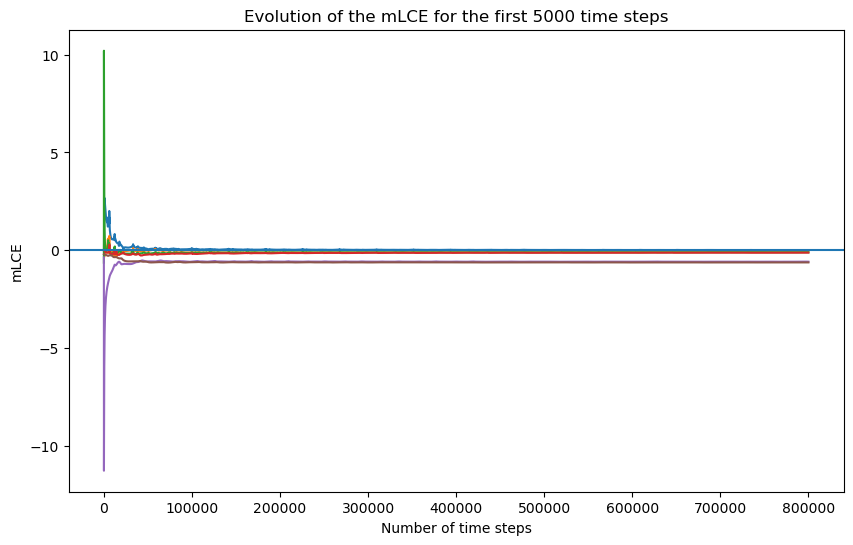

In [37]:
# Plot of mLCE evolution
plt.figure(figsize = (10,6))
plt.plot(history)
plt.xlabel("Number of time steps")
plt.ylabel("mLCE")
plt.title("Evolution of the mLCE for the first 5000 time steps")
plt.axhline(0,)
plt.show()

In [46]:
from LyapunovExponentsHomogeneous import LyapunovExponents

In [47]:
params

{'tau_e': 8,
 'tau_i': 8,
 'tau_se': 1,
 'tau_si': 5,
 'nu_e': -5,
 'nu_i': -5,
 'Delta_e': 1,
 'Delta_i': 1,
 'Jee': 5,
 'Jei': 13,
 'Jii': 5,
 'Jie': 13,
 'Iext_i': 0,
 'Iext_e': 10.5,
 'eps': 11}

In [48]:
save = False
result = LyapunovExponents(Nvariables,params,save)

(81,)
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80


In [520]:
result.shape

(6, 9)

In [527]:
len(np.arange(4,12.1,step=0.1))

81

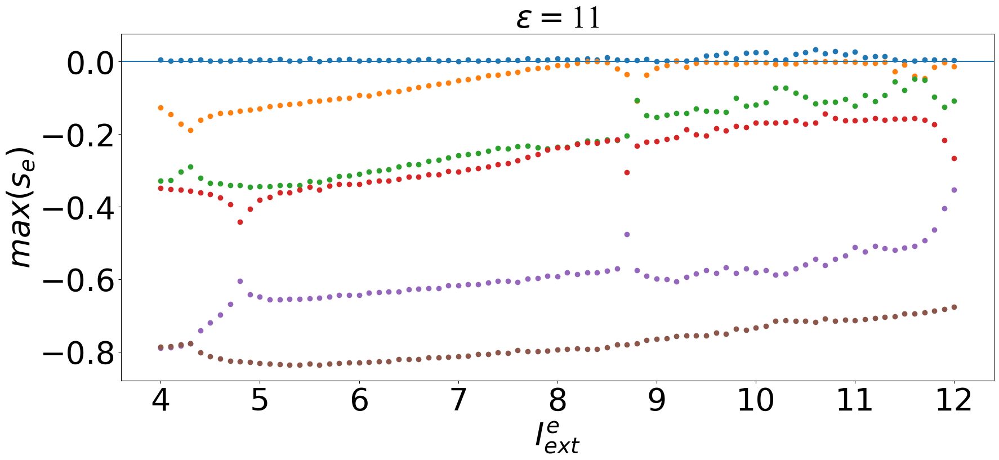

In [49]:
fig=plt.figure(figsize=(20,8))
ax=plt.axes()
#plt.plot(sol.t,sol.y[5,:],color='yellow',linewidth=6,label='s_i')    legend_handles = []
for idx in range(Nvariables):
    #plt.plot(np.arange(4,12.1,step=0.1),result[idx,:])
    plt.scatter(np.arange(4,12.1,step=0.1),result[idx,:])
plt.xlabel(r'$I_{ext}^e$',fontsize=40)
plt.ylabel(r'$max(s_e)$',fontsize=40)
plt.xticks(fontsize=40)#,rotation=45)
plt.yticks(fontsize=40)
plt.axhline(0)
plt.title(r'$\epsilon=$'+str(params['eps']),fontsize=40,fontname='Times New Roman')
plt.savefig('PeriodDoublings/LyapunovExponents/Scattereps'+str(params['eps'])+'.png',dpi=500,bbox_inches=Bbox([[0,-1],fig.get_size_inches()]))

In [538]:
np.savez('FirstTryLyapunovExponents.npz',result=result)


In [7]:
data = np.load('FirstTryLyapunovExponents.npz')

Text(0.5, 1.0, '$\\epsilon=$11')

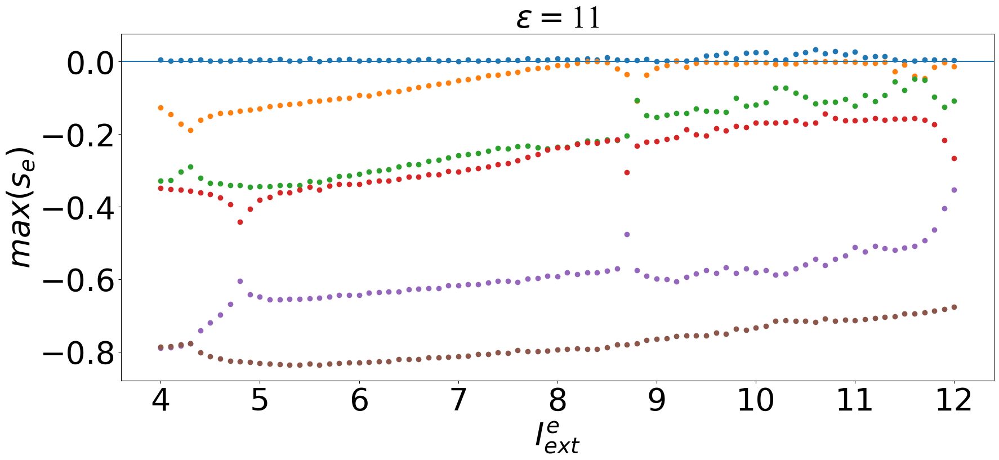

In [32]:
fig=plt.figure(figsize=(20,8))
ax=plt.axes()
#plt.plot(sol.t,sol.y[5,:],color='yellow',linewidth=6,label='s_i')    legend_handles = []
for idx in range(Nvariables):
    plt.scatter(np.arange(4,12.1,step=0.1),result[idx,:])
plt.xlabel(r'$I_{ext}^e$',fontsize=40)
plt.ylabel(r'$max(s_e)$',fontsize=40)
plt.xticks(fontsize=40)#,rotation=45)
plt.yticks(fontsize=40)
plt.axhline(0)
plt.title(r'$\epsilon=$'+str(params['eps']),fontsize=40,fontname='Times New Roman')

# Lyapunov with Nolds package

In [24]:
lyap_vector=nolds.lyap_e(sol.y[2,len(sol.t)-int(500/h):len(sol.t)])

In [21]:
lyap_vector

array([ 0.05938965,  0.00222339, -0.00894717, -0.12480727])

# Bestia Simulation

In [4]:
from Bestia import Bestial

In [5]:
min_Iext_e = 14.1
max_Iext_e = 16
long_Iext_e = int((max_Iext_e-min_Iext_e)/0.05)

In [6]:
vector_Iext_e = np.linspace(min_Iext_e,max_Iext_e,long_Iext_e+1)

In [7]:
vector_Iext_e

array([14.1 , 14.15, 14.2 , 14.25, 14.3 , 14.35, 14.4 , 14.45, 14.5 ,
       14.55, 14.6 , 14.65, 14.7 , 14.75, 14.8 , 14.85, 14.9 , 14.95,
       15.  , 15.05, 15.1 , 15.15, 15.2 , 15.25, 15.3 , 15.35, 15.4 ,
       15.45, 15.5 , 15.55, 15.6 , 15.65, 15.7 , 15.75, 15.8 , 15.85,
       15.9 , 15.95, 16.  ])

In [8]:
vector_Iext_e,vector_eps,dataFloquetReal,dataFloquetImaginary,dataStatus = Bestial()

 -----------  Iext_e:  14.1 eps:  0.0   -----------
Exit status:  1
Exit message:  The solution converged.
Function evaluations:  12
Final residuals:  [-1.38777878e-16 -5.82867088e-16 -4.88498131e-15 -1.38777878e-16
 -1.73472348e-18 -1.99840144e-15  1.38777878e-17]
InitCond status: 2
Rectified Status:  2
[-4.24485186e-09 -4.24485186e-09 -4.24485186e-09 -4.24485186e-09
 -4.24485186e-09 -4.24485186e-09 -4.24485186e-09 -4.24485186e-09
 -4.24485186e-09 -4.24485186e-09 -4.24485186e-09 -4.24485186e-09
 -4.24485186e-09 -4.24485186e-09 -4.24485186e-09 -4.24485186e-09
 -4.24485186e-09 -4.24485186e-09 -4.24485186e-09 -4.24485186e-09
 -4.24485186e-09 -4.24485186e-09 -4.24485186e-09 -4.24485186e-09
 -4.24485186e-09 -4.24485186e-09 -4.24485186e-09 -4.24485186e-09
 -4.24485186e-09 -4.24485186e-09 -4.24485186e-09 -4.24485186e-09
 -4.24485186e-09 -4.24485186e-09 -4.24485186e-09 -4.24485186e-09
 -4.24485186e-09 -4.24485186e-09 -4.24485186e-09 -4.24485186e-09
 -4.24485186e-09 -4.24485186e-09 -4.24485186

In [39]:
vector_Iext_e

array([1.  , 1.05, 1.1 , 1.15, 1.2 , 1.25, 1.3 , 1.35, 1.4 , 1.45, 1.5 ,
       1.55, 1.6 , 1.65, 1.7 , 1.75, 1.8 , 1.85, 1.9 , 1.95, 2.  , 2.05,
       2.1 , 2.15, 2.2 , 2.25, 2.3 , 2.35, 2.4 , 2.45, 2.5 , 2.55, 2.6 ,
       2.65, 2.7 , 2.75, 2.8 , 2.85, 2.9 , 2.95, 3.  ])

In [40]:
vector_eps

array([ 0.  ,  0.05,  0.1 ,  0.15,  0.2 ,  0.25,  0.3 ,  0.35,  0.4 ,
        0.45,  0.5 ,  0.55,  0.6 ,  0.65,  0.7 ,  0.75,  0.8 ,  0.85,
        0.9 ,  0.95,  1.  ,  1.05,  1.1 ,  1.15,  1.2 ,  1.25,  1.3 ,
        1.35,  1.4 ,  1.45,  1.5 ,  1.55,  1.6 ,  1.65,  1.7 ,  1.75,
        1.8 ,  1.85,  1.9 ,  1.95,  2.  ,  2.05,  2.1 ,  2.15,  2.2 ,
        2.25,  2.3 ,  2.35,  2.4 ,  2.45,  2.5 ,  2.55,  2.6 ,  2.65,
        2.7 ,  2.75,  2.8 ,  2.85,  2.9 ,  2.95,  3.  ,  3.05,  3.1 ,
        3.15,  3.2 ,  3.25,  3.3 ,  3.35,  3.4 ,  3.45,  3.5 ,  3.55,
        3.6 ,  3.65,  3.7 ,  3.75,  3.8 ,  3.85,  3.9 ,  3.95,  4.  ,
        4.05,  4.1 ,  4.15,  4.2 ,  4.25,  4.3 ,  4.35,  4.4 ,  4.45,
        4.5 ,  4.55,  4.6 ,  4.65,  4.7 ,  4.75,  4.8 ,  4.85,  4.9 ,
        4.95,  5.  ,  5.05,  5.1 ,  5.15,  5.2 ,  5.25,  5.3 ,  5.35,
        5.4 ,  5.45,  5.5 ,  5.55,  5.6 ,  5.65,  5.7 ,  5.75,  5.8 ,
        5.85,  5.9 ,  5.95,  6.  ,  6.05,  6.1 ,  6.15,  6.2 ,  6.25,
        6.3 ,  6.35,

In [9]:
dataFloquetReal

array([[[            nan,             nan,             nan, ...,
                     nan,             nan,             nan],
        [            nan,             nan,             nan, ...,
                     nan,             nan,             nan],
        [            nan,             nan,             nan, ...,
                     nan,             nan,             nan],
        ...,
        [            nan,             nan,             nan, ...,
                     nan,             nan,             nan],
        [            nan,             nan,             nan, ...,
                     nan,             nan,             nan],
        [            nan,             nan,             nan, ...,
                     nan,             nan,             nan]],

       [[            nan,             nan,             nan, ...,
                     nan,             nan,             nan],
        [            nan,             nan,             nan, ...,
                     nan,             

In [10]:
dataFloquetImaginary

array([[[       nan,        nan,        nan, ...,        nan,
                nan,        nan],
        [       nan,        nan,        nan, ...,        nan,
                nan,        nan],
        [       nan,        nan,        nan, ...,        nan,
                nan,        nan],
        ...,
        [       nan,        nan,        nan, ...,        nan,
                nan,        nan],
        [       nan,        nan,        nan, ...,        nan,
                nan,        nan],
        [       nan,        nan,        nan, ...,        nan,
                nan,        nan]],

       [[       nan,        nan,        nan, ...,        nan,
                nan,        nan],
        [       nan,        nan,        nan, ...,        nan,
                nan,        nan],
        [       nan,        nan,        nan, ...,        nan,
                nan,        nan],
        ...,
        [0.        , 0.        , 0.        , ..., 0.04010679,
         0.04039063, 0.04062597],
        [0. 

In [64]:
dataStatus

array([[2., 2., 2., ..., 0., 0., 0.],
       [2., 2., 2., ..., 0., 0., 0.],
       [2., 2., 2., ..., 0., 0., 0.],
       ...,
       [2., 2., 2., ..., 0., 0., 0.],
       [2., 2., 2., ..., 0., 0., 0.],
       [2., 2., 2., ..., 0., 0., 0.]])

In [9]:
np.savez('ImprovedSims/Left_16.npz',vector_Iext_e=vector_Iext_e,vector_eps=vector_eps,dataFloquetReal=dataFloquetReal,dataFloquetImaginary=dataFloquetImaginary,dataStatus=dataStatus)


## Organize improved sims

### LeftMost

In [10]:
dataLeftMost = np.load('ImprovedSims/LefttMost.npz')

In [11]:
FloquetRealLeftMost = dataLeftMost['dataFloquetReal']
FloquetRealLeftMost.shape

(41, 661, 90)

In [12]:
FloquetImagLeftMost = dataLeftMost['dataFloquetImaginary']
FloquetImagLeftMost.shape

(41, 661, 90)

In [13]:
StatusLeftMost = dataLeftMost['dataStatus']
StatusLeftMost.shape

(41, 661)

In [16]:
Vector_Iext_eLeftMost = dataLeftMost['vector_Iext_e']
Vector_Iext_eLeftMost

array([1.  , 1.05, 1.1 , 1.15, 1.2 , 1.25, 1.3 , 1.35, 1.4 , 1.45, 1.5 ,
       1.55, 1.6 , 1.65, 1.7 , 1.75, 1.8 , 1.85, 1.9 , 1.95, 2.  , 2.05,
       2.1 , 2.15, 2.2 , 2.25, 2.3 , 2.35, 2.4 , 2.45, 2.5 , 2.55, 2.6 ,
       2.65, 2.7 , 2.75, 2.8 , 2.85, 2.9 , 2.95, 3.  ])

In [37]:
Vector_epsLeftMost = dataLeftMost['vector_eps']
Vector_epsLeftMost.shape

(661,)

In [39]:
len(np.arange(1,step=0.05))

20

In [49]:
nan_matrix = np.full((len(np.arange(1,step=0.05)),len(Vector_epsLeftMost),90), np.nan)
nan_matrix.shape

(20, 661, 90)

In [51]:
nan_status = np.full((len(np.arange(1,step=0.05)),len(Vector_epsLeftMost)), np.nan)
nan_status.shape

(20, 661)

In [42]:
addzeros = np.nan([len(Vector_epsLeftMost),len(np.arange(1,step=0.05))])

TypeError: 'float' object is not callable

### $I_{ext}^E=5$

In [23]:
data5 = np.load('ImprovedSims/Left_5.npz')
FloquetRealLeft5 = data5['dataFloquetReal']
#FloquetRealLeft5.shape
FloquetImagLeft5 = data5['dataFloquetImaginary']
#FloquetImagLeft5.shape
StatusLeft5 = data5['dataStatus']
#StatusLeft5.shape
Vector_Iext_eLeft5 = data5['vector_Iext_e']
#Vector_Iext_eLeft5.shape
Vector_eps5 = data5['vector_eps']
#Vector_eps5.shape

### $I_{ext}^E=6$

In [24]:
data6 = np.load('ImprovedSims/Left_6.npz')
FloquetRealLeft6 = data6['dataFloquetReal']
#FloquetRealLeft5.shape
FloquetImagLeft6 = data6['dataFloquetImaginary']
#FloquetImagLeft5.shape
StatusLeft6 = data6['dataStatus']
#StatusLeft5.shape
Vector_Iext_eLeft6 = data6['vector_Iext_e']
#Vector_Iext_eLeft5.shape
Vector_eps6 = data6['vector_eps']
#Vector_eps5.shape

### $I_{ext}^E = 7$

In [25]:
data7 = np.load('ImprovedSims/Left_7.npz')
FloquetRealLeft7 = data7['dataFloquetReal']
#FloquetRealLeft5.shape
FloquetImagLeft7 = data7['dataFloquetImaginary']
#FloquetImagLeft5.shape
StatusLeft7 = data7['dataStatus']
#StatusLeft5.shape
Vector_Iext_eLeft7 = data7['vector_Iext_e']
#Vector_Iext_eLeft5.shape
Vector_eps7 = data7['vector_eps']
#Vector_eps5.shape

### $I_{ext}^E = 9$

In [26]:
data9 = np.load('ImprovedSims/Left_9.npz')
FloquetRealLeft9 = data9['dataFloquetReal']
#FloquetRealLeft5.shape
FloquetImagLeft9 = data9['dataFloquetImaginary']
#FloquetImagLeft5.shape
StatusLeft9 = data9['dataStatus']
#StatusLeft5.shape
Vector_Iext_eLeft9 = data9['vector_Iext_e']
#Vector_Iext_eLeft5.shape
Vector_eps9 = data9['vector_eps']
#Vector_eps5.shape

### $I_{ext}^E = 11$

In [27]:
data11 = np.load('ImprovedSims/Left_11.npz')
FloquetRealLeft11 = data11['dataFloquetReal']
#FloquetRealLeft5.shape
FloquetImagLeft11 = data11['dataFloquetImaginary']
#FloquetImagLeft5.shape
StatusLeft11 = data11['dataStatus']
#StatusLeft5.shape
Vector_Iext_eLeft11 = data11['vector_Iext_e']
#Vector_Iext_eLeft5.shape
Vector_eps11 = data11['vector_eps']
#Vector_eps5.shape

### $I_{ext}^E=14$

In [28]:
data14 = np.load('ImprovedSims/Left_14.npz')
FloquetRealLeft14 = data14['dataFloquetReal']
#FloquetRealLeft5.shape
FloquetImagLeft14 = data14['dataFloquetImaginary']
#FloquetImagLeft5.shape
StatusLeft14 = data14['dataStatus']
#StatusLeft5.shape
Vector_Iext_eLeft14 = data14['vector_Iext_e']
#Vector_Iext_eLeft5.shape
Vector_eps14 = data14['vector_eps']
#Vector_eps5.shape

### $I_{ext}^E = 16$

In [29]:
data16 = np.load('ImprovedSims/Left_16.npz')
FloquetRealLeft16 = data16['dataFloquetReal']
#FloquetRealLeft5.shape
FloquetImagLeft16 = data16['dataFloquetImaginary']
#FloquetImagLeft5.shape
StatusLeft16 = data16['dataStatus']
#StatusLeft5.shape
Vector_Iext_eLeft16 = data16['vector_Iext_e']
#Vector_Iext_eLeft5.shape
Vector_eps16 = data16['vector_eps']
#Vector_eps5.shape

## Concatenate all

In [34]:
ConcatenateFloquetRealImproved = np.concatenate([FloquetRealLeftMost,FloquetRealLeft5,FloquetRealLeft6,FloquetRealLeft7,FloquetRealLeft9,FloquetRealLeft11,FloquetRealLeft14,FloquetRealLeft16])
ConcatenateFloquetImagImproved = np.concatenate([FloquetImagLeftMost,FloquetImagLeft5,FloquetImagLeft6,FloquetImagLeft7,FloquetImagLeft9,FloquetImagLeft11,FloquetImagLeft14,FloquetImagLeft16])
ConcatenateStatusImproved = np.concatenate([StatusLeftMost,StatusLeft5,StatusLeft6,StatusLeft7,StatusLeft9,StatusLeft11,StatusLeft14,StatusLeft16])
ConcatenateVector_Iext_eImproved = np.concatenate([Vector_Iext_eLeftMost,Vector_Iext_eLeft5,Vector_Iext_eLeft6,Vector_Iext_eLeft7,Vector_Iext_eLeft9,Vector_Iext_eLeft11,Vector_Iext_eLeft14,Vector_Iext_eLeft16])
ConcatenateVector_epsImproved = np.concatenate([Vector_epsLeftMost,Vector_eps5,Vector_eps6,Vector_eps7,Vector_eps9,Vector_eps11,Vector_eps14,Vector_eps16])




In [52]:
ConcatenateFloquetRealImproved = np.concatenate([nan_matrix,FloquetRealLeftMost,FloquetRealLeft5,FloquetRealLeft6,FloquetRealLeft7,FloquetRealLeft9,FloquetRealLeft11,FloquetRealLeft14,FloquetRealLeft16])
ConcatenateFloquetImagImproved = np.concatenate([nan_matrix,FloquetImagLeftMost,FloquetImagLeft5,FloquetImagLeft6,FloquetImagLeft7,FloquetImagLeft9,FloquetImagLeft11,FloquetImagLeft14,FloquetImagLeft16])
ConcatenateStatusImproved = np.concatenate([nan_status,StatusLeftMost,StatusLeft5,StatusLeft6,StatusLeft7,StatusLeft9,StatusLeft11,StatusLeft14,StatusLeft16])
ConcatenateVector_Iext_eImproved = np.concatenate([np.arange(1,step=0.05),Vector_Iext_eLeftMost,Vector_Iext_eLeft5,Vector_Iext_eLeft6,Vector_Iext_eLeft7,Vector_Iext_eLeft9,Vector_Iext_eLeft11,Vector_Iext_eLeft14,Vector_Iext_eLeft16])
ConcatenateVector_epsImproved = np.concatenate([Vector_epsLeftMost,Vector_eps5,Vector_eps6,Vector_eps7,Vector_eps9,Vector_eps11,Vector_eps14,Vector_eps16])



In [53]:
np.savez('ImprovedSims/ConcatenateImproved.npz',vector_Iext_e=ConcatenateVector_Iext_eImproved,vector_eps=Vector_eps11,dataFloquetReal=ConcatenateFloquetRealImproved,dataFloquetImaginary=ConcatenateFloquetImagImproved,dataStatus=ConcatenateStatusImproved)


## Past recordings

In [9]:
saved_data = np.load('BestiaConcatenateLeftRight.npz')

In [10]:
dataFloquetRealConcatenated = saved_data['dataFloquetReal']
dataFloquetRealConcatenated.shape

(102, 251, 90)

In [11]:
dataFloquetImagConcatenated = saved_data['dataFloquetImaginary']
dataFloquetImagConcatenated

array([[[       nan,        nan,        nan, ...,        nan,
                nan,        nan],
        [       nan,        nan,        nan, ...,        nan,
                nan,        nan],
        [       nan,        nan,        nan, ...,        nan,
                nan,        nan],
        ...,
        [0.        , 0.07474748, 0.07474748, ..., 0.07474748,
         0.07474748, 0.07474748],
        [0.        , 0.07417299, 0.07417299, ..., 0.07417299,
         0.07417299, 0.07417299],
        [0.        , 0.07352302, 0.07352302, ..., 0.07352302,
         0.07352302, 0.07352302]],

       [[       nan,        nan,        nan, ...,        nan,
                nan,        nan],
        [       nan,        nan,        nan, ...,        nan,
                nan,        nan],
        [       nan,        nan,        nan, ...,        nan,
                nan,        nan],
        ...,
        [0.        , 0.07498852, 0.07498852, ..., 0.07498852,
         0.07498852, 0.07498852],
        [0. 

In [12]:
dataStatusConcatenated = saved_data['dataStatus']
dataStatusConcatenated

array([[0., 0., 0., ..., 2., 2., 2.],
       [0., 0., 0., ..., 2., 2., 2.],
       [0., 0., 0., ..., 2., 2., 2.],
       ...,
       [2., 2., 2., ..., 0., 0., 0.],
       [2., 2., 2., ..., 0., 0., 0.],
       [2., 2., 2., ..., 0., 0., 0.]])

In [13]:
dataVector_Iext_eConcatenated = saved_data['vector_Iext_e']
dataVector_Iext_eConcatenated 

array([ 4. ,  4.1,  4.2,  4.3,  4.4,  4.5,  4.6,  4.7,  4.8,  4.9,  5. ,
        5.1,  5.2,  5.3,  5.4,  5.5,  5.6,  5.7,  5.8,  5.9,  6. ,  6.1,
        6.2,  6.3,  6.4,  6.5,  6.6,  6.7,  6.8,  6.9,  7. ,  7.1,  7.2,
        7.3,  7.4,  7.5,  7.6,  7.7,  7.8,  7.9,  8. ,  8. ,  8.1,  8.2,
        8.3,  8.4,  8.5,  8.6,  8.7,  8.8,  8.9,  9. ,  9.1,  9.2,  9.3,
        9.4,  9.5,  9.6,  9.7,  9.8,  9.9, 10. , 10.1, 10.2, 10.3, 10.4,
       10.5, 10.6, 10.7, 10.8, 10.9, 11. , 11.1, 11.2, 11.3, 11.4, 11.5,
       11.6, 11.7, 11.8, 11.9, 12. , 12.1, 12.2, 12.3, 12.4, 12.5, 12.6,
       12.7, 12.8, 12.9, 13. , 13.1, 13.2, 13.3, 13.4, 13.5, 13.6, 13.7,
       13.8, 13.9, 14. ])

In [14]:
dataVector_epsConcatenated = saved_data['vector_eps']
dataVector_epsConcatenated 

array([ 0. ,  0.1,  0.2,  0.3,  0.4,  0.5,  0.6,  0.7,  0.8,  0.9,  1. ,
        1.1,  1.2,  1.3,  1.4,  1.5,  1.6,  1.7,  1.8,  1.9,  2. ,  2.1,
        2.2,  2.3,  2.4,  2.5,  2.6,  2.7,  2.8,  2.9,  3. ,  3.1,  3.2,
        3.3,  3.4,  3.5,  3.6,  3.7,  3.8,  3.9,  4. ,  4.1,  4.2,  4.3,
        4.4,  4.5,  4.6,  4.7,  4.8,  4.9,  5. ,  5.1,  5.2,  5.3,  5.4,
        5.5,  5.6,  5.7,  5.8,  5.9,  6. ,  6.1,  6.2,  6.3,  6.4,  6.5,
        6.6,  6.7,  6.8,  6.9,  7. ,  7.1,  7.2,  7.3,  7.4,  7.5,  7.6,
        7.7,  7.8,  7.9,  8. ,  8.1,  8.2,  8.3,  8.4,  8.5,  8.6,  8.7,
        8.8,  8.9,  9. ,  9.1,  9.2,  9.3,  9.4,  9.5,  9.6,  9.7,  9.8,
        9.9, 10. , 10.1, 10.2, 10.3, 10.4, 10.5, 10.6, 10.7, 10.8, 10.9,
       11. , 11.1, 11.2, 11.3, 11.4, 11.5, 11.6, 11.7, 11.8, 11.9, 12. ,
       12.1, 12.2, 12.3, 12.4, 12.5, 12.6, 12.7, 12.8, 12.9, 13. , 13.1,
       13.2, 13.3, 13.4, 13.5, 13.6, 13.7, 13.8, 13.9, 14. , 14.1, 14.2,
       14.3, 14.4, 14.5, 14.6, 14.7, 14.8, 14.9, 15

In [78]:
dataFloquetReal.shape

(61, 251, 90)

In [79]:
dataFloquetRealLeft.shape

(41, 251, 90)

In [93]:
ConcatenateStatus.shape

(102, 251)

In [94]:
ConcatenateVector_Iext_e.shape

(102,)

In [97]:
ConcatenateVector_eps.shape

(251,)

In [29]:
ConcatenateFloquetReal = np.concatenate([ConcatenateFloquetReal,dataFloquetReal])
ConcatenateFloquetImag = np.concatenate([ConcatenateFloquetImag,dataFloquetImaginary])
ConcatenateStatus = np.concatenate([ConcatenateStatus,dataStatus])
ConcatenateVector_Iext_e = np.concatenate([ConcatenateVector_Iext_e,vector_Iext_e])
ConcatenateVector_eps = vector_eps

In [15]:
ConcatenateFloquetReal = np.concatenate([dataFloquetReal,dataFloquetRealConcatenated])
ConcatenateFloquetImag = np.concatenate([dataFloquetImaginary,dataFloquetImagConcatenated])
ConcatenateStatus = np.concatenate([dataStatus,dataStatusConcatenated])
ConcatenateVector_Iext_e = np.concatenate([vector_Iext_e,dataVector_Iext_eConcatenated])
ConcatenateVector_eps = vector_eps

In [94]:
np.savez('BestiaConcatenateLeftRightMost.npz',vector_Iext_e=ConcatenateVector_Iext_e,vector_eps=ConcatenateVector_eps,dataFloquetReal=ConcatenateFloquetReal,dataFloquetImaginary=ConcatenateFloquetImag,dataStatus=ConcatenateStatus)


In [93]:
ConcatenateVector_Iext_e.shape

(161,)

In [52]:
ConcatenateFloquetReal.shape

(164, 251, 90)

In [51]:
ConcatenateFloquetReal = np.delete(ConcatenateFloquetReal,41,axis=0)
pop.shape

(163, 251, 90)

In [89]:
ConcatenateVector_Iext_e = np.delete(ConcatenateVector_Iext_e,81)
ConcatenateFloquetReal = np.delete(ConcatenateFloquetReal,81,axis=0)
ConcatenateFloquetImag = np.delete(ConcatenateFloquetImag,81,axis=0)
ConcatenateStatus = np.delete(ConcatenateStatus,81,axis=0)


In [92]:
ConcatenateStatus.shape

(161, 251)

In [11]:
indices = np.zeros((len(vector_Iext_e),len(vector_eps)))
maxFloquet = np.zeros((len(vector_Iext_e),len(vector_eps)))
Floquet_2 = np.zeros((len(vector_Iext_e),len(vector_eps)))
Floquet_3 = np.zeros((len(vector_Iext_e),len(vector_eps)))
Floquet_4 = np.zeros((len(vector_Iext_e),len(vector_eps)))
Floquet_5 = np.zeros((len(vector_Iext_e),len(vector_eps)))
Floquet_6 = np.zeros((len(vector_Iext_e),len(vector_eps)))
Floquet_7 = np.zeros((len(vector_Iext_e),len(vector_eps)))
Floquet_8 = np.zeros((len(vector_Iext_e),len(vector_eps)))
Floquet_9 = np.zeros((len(vector_Iext_e),len(vector_eps)))
Floquet_10 = np.zeros((len(vector_Iext_e),len(vector_eps)))

for i in range(len(vector_Iext_e)):
    for j in range(len(vector_eps)):
        Floquet = dataFloquetReal[i,j,:]
        print(Floquet[0])
        maxFloquet[i,j] = np.amax(Floquet[1:len(Floquet)])
        if not np.isnan(maxFloquet[i,j]):
            indices[i,j] =  np.argmax(Floquet[1:len(Floquet)])
        else:
            indices[i,j] = np.nan
        print(indices[i,j])
        Floquet_2[i,j] = Floquet[1]
        Floquet_3[i,j] = Floquet[2]
        Floquet_4[i,j] = Floquet[3]
        Floquet_5[i,j] = Floquet[4]
        Floquet_6[i,j] = Floquet[5]
        Floquet_7[i,j] = Floquet[6]
        Floquet_8[i,j] = Floquet[7]
        Floquet_9[i,j] = Floquet[8]
        Floquet_10[i,j] = Floquet[9]

nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
-1.4748510065643817e-09
0.0
-2.716939909105167e-09
0.0
-1.716647285713281e-09
0.0
-8.826699653276204e-10
0.0
-1.9389367350665404e-09
0.0
2.338684796475469e-08
0.0
1.81538696548312e-08
1.0
1.358913877502752e-08
0.0
-9.54041179188939e-09
0.0
-1.7051362220987625e-08
0.0
-1.7938621566585627e-08
1.0
1.2297101350784046e-08
0.0
1.062317421215382e-08
0.0
-6.787373772975625e-09
0.0
-7.055452600930025e-08
0.0
3.0812299343470336e-08
0.0
1.34507751036804e-09
2.0
-9.842539133714327e-08
0.0
1.9464574936364307e-08
0.0
-9.653867166471212e-08
0.0
-9.958544580852584e-08
0.0
-2.4090280975402806e-07
0.0
nan
nan
7.569469258769558e-09
0.0
-1.513530964971773e-08
1.0
-3.0728720344892586e-08
1.0
4.6243261032025707e-08
0.0
3.234148268371485e-08
0.0
-1.3878909318144854e-08
1.0
-3.6425285090443074e-09
0.0
7.343504468923395e-08
0.0
-3.248691

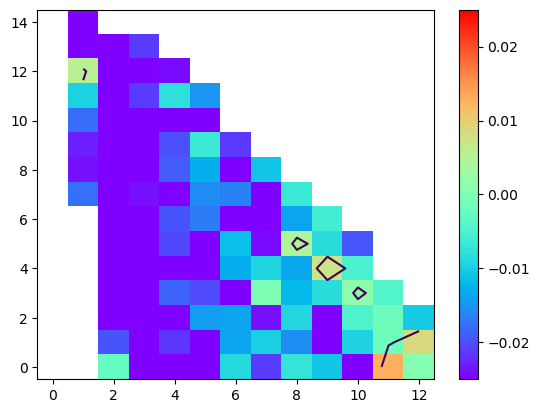

In [12]:
%matplotlib inline  
plt.imshow(np.transpose(maxFloquet),cmap='rainbow', interpolation='nearest',vmin=-0.025,vmax=0.025)
cbar = plt.colorbar()
plt.contour(np.transpose(maxFloquet),levels=[0])
plt.gca().set_aspect('auto')
plt.gca().invert_yaxis()

In [220]:
indices = np.zeros((len(ConcatenateVector_Iext_e),len(ConcatenateVector_eps)))
maxFloquet = np.zeros((len(ConcatenateVector_Iext_e),len(ConcatenateVector_eps)))
Floquet_2 = np.zeros((len(ConcatenateVector_Iext_e),len(ConcatenateVector_eps)))
Floquet_3 = np.zeros((len(ConcatenateVector_Iext_e),len(ConcatenateVector_eps)))
Floquet_4 = np.zeros((len(ConcatenateVector_Iext_e),len(ConcatenateVector_eps)))
Floquet_5 = np.zeros((len(ConcatenateVector_Iext_e),len(ConcatenateVector_eps)))
Floquet_6 = np.zeros((len(ConcatenateVector_Iext_e),len(ConcatenateVector_eps)))
Floquet_7 = np.zeros((len(ConcatenateVector_Iext_e),len(ConcatenateVector_eps)))
Floquet_8 = np.zeros((len(ConcatenateVector_Iext_e),len(ConcatenateVector_eps)))
Floquet_9 = np.zeros((len(ConcatenateVector_Iext_e),len(ConcatenateVector_eps)))
Floquet_10 = np.zeros((len(ConcatenateVector_Iext_e),len(ConcatenateVector_eps)))

for i in range(len(ConcatenateVector_Iext_e)):
    for j in range(len(ConcatenateVector_eps)):
        Floquet = ConcatenateFloquetReal[i,j,:]
        print(Floquet[0])
        maxFloquet[i,j] = np.amax(Floquet[1:len(Floquet)])
        if not np.isnan(maxFloquet[i,j]):
            indices[i,j] =  np.argmax(Floquet[1:len(Floquet)])
        else:
            indices[i,j] = np.nan
        print(indices[i,j])
        Floquet_2[i,j] = Floquet[1]
        Floquet_3[i,j] = Floquet[2]
        Floquet_4[i,j] = Floquet[3]
        Floquet_5[i,j] = Floquet[4]
        Floquet_6[i,j] = Floquet[5]
        Floquet_7[i,j] = Floquet[6]
        Floquet_8[i,j] = Floquet[7]
        Floquet_9[i,j] = Floquet[8]
        Floquet_10[i,j] = Floquet[9]

nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan


In [71]:
maxFloquet.shape

(162, 251)

In [27]:
maxFloquet = np.zeros((len(vector_Iext_e),len(vector_eps)))
for i in range(len(vector_Iext_e)):
    for j in range(len(vector_eps)):
        Floquet = dataFloquetReal[i,j,:]
        print(Floquet[0])
        maxFloquet[i,j] = np.amax(Floquet[1:len(Floquet)])

5.489838902308662e-09
1.2760115703700527e-07
1.2672547314094087e-07
-2.1312295022040215e-08
1.3679321196496934e-07
-3.665010706668093e-08
8.887738614233513e-08
1.26266419302169e-07
-5.544062073044296e-08
-7.964897114973621e-08
-6.409075816071447e-08
-1.1529887415952236e-07
-1.4042284703085697e-07
-1.2204757015943183e-07
-1.3133263247576535e-07
-2.5622261887945e-07
-2.3934477512695545e-07
-2.1222077162170023e-07
-9.35716136995228e-08
-1.2244564388260675e-07
-2.182053695734782e-07
-1.1486276565074492e-07
-1.5679127262634455e-07
-1.3771014122791128e-07
-1.573021615590565e-07
-2.2845152063557611e-07
-2.3994907044183927e-07
-2.302480548106611e-07
-1.4424737134395488e-07
-1.4935956677343383e-07
-1.4608017886871287e-07
-1.4155437376041777e-07
-9.675861065131889e-08
-1.1113681333518856e-07
-7.136520277727368e-08
-3.6073548714427846e-08
-5.1505390266913795e-08
-7.419564289697704e-08
-2.710167979751879e-08
9.245341572873777e-08
-1.1872727852759046e-07
-1.4068932207910258e-07
-8.584706515546736e-

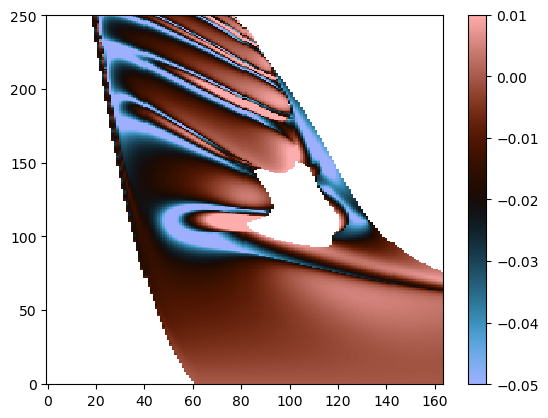

In [31]:
%matplotlib inline  
fig = plt.figure()
plt.imshow(np.transpose(Floquet_2),cmap='berlin', interpolation='nearest',vmin=-0.05,vmax=0.01)
plt.gca().set_aspect('auto')
plt.gca().invert_yaxis()
cbar = plt.colorbar()

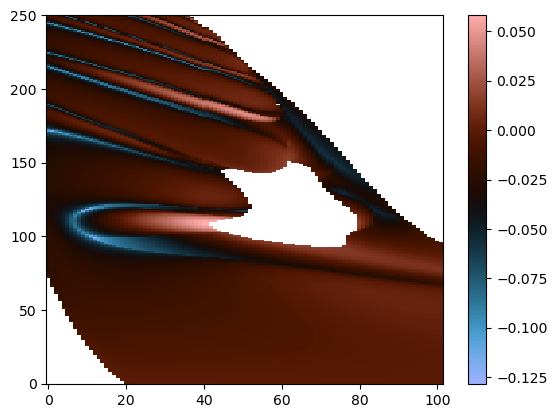

In [127]:
%matplotlib inline  
fig = plt.figure()
plt.imshow(np.transpose(Floquet_3),cmap='berlin', interpolation='nearest')
plt.gca().set_aspect('auto')
plt.gca().invert_yaxis()
cbar = plt.colorbar()

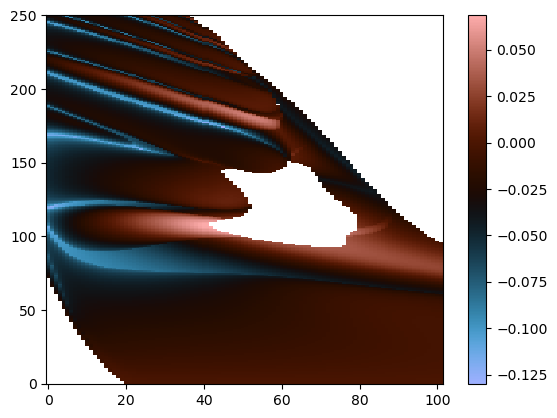

In [129]:
%matplotlib inline  
fig = plt.figure()
plt.imshow(np.transpose(Floquet_9),cmap='berlin', interpolation='nearest')
plt.gca().set_aspect('auto')
plt.gca().invert_yaxis()
cbar = plt.colorbar()

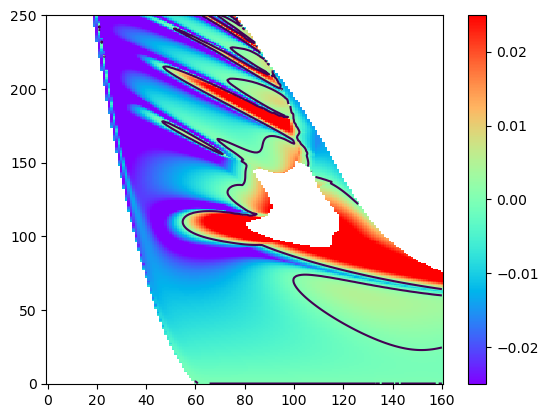

: 

In [224]:
%matplotlib inline  
plt.imshow(np.transpose(maxFloquet),cmap='rainbow', interpolation='nearest',vmin=-0.025,vmax=0.025)
cbar = plt.colorbar()
plt.contour(np.transpose(maxFloquet),levels=[0])
plt.gca().set_aspect('auto')
plt.gca().invert_yaxis()


In [217]:
max([np.nan,np.nan])

nan

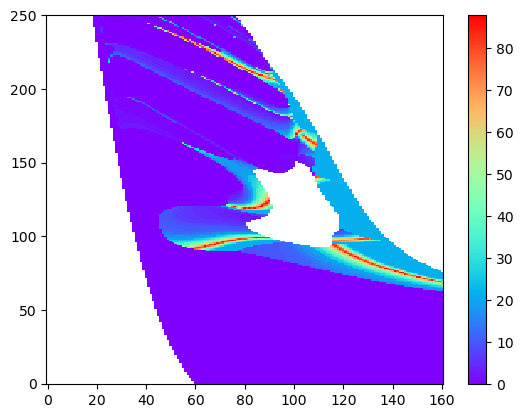

In [221]:
%matplotlib inline  
plt.imshow(np.transpose(indices),cmap='rainbow', interpolation='nearest')#,vmin=-0.025,vmax=0.025)
plt.gca().set_aspect('auto')
plt.gca().invert_yaxis()
cbar = plt.colorbar()

In [214]:
np.unique(indices,return_counts=True)

(array([ 0.,  1.,  2.,  3.,  4.,  5.,  6.,  7.,  8.,  9., 10., 11., 12.,
        13., 14., 15., 16., 17., 18., 19., 20., 21., 22., 23., 24., 25.,
        26., 27., 28., 29., 30., 31., 32., 33., 34., 35., 36., 37., 38.,
        39., 40., 41., 42., 43., 44., 45., 46., 47., 48., 49., 50., 51.,
        52., 53., 54., 55., 56., 57., 58., 59., 60., 61., 62., 63., 64.,
        65., 66., 67., 68., 69., 70., 71., 72., 73., 74., 75., 76., 77.,
        78., 79., 80., 81., 82., 83., 84., 85., 86., 87., 88.]),
 array([34049,   523,   320,   246,   266,   339,   203,   118,    54,
          153,   339,   233,    68,    58,    79,    61,   121,    56,
          153,   142,   101,  1371,     5,    11,    42,    56,    55,
           55,    42,    31,    42,    40,    14,    58,    25,    29,
           40,    27,    40,    18,    11,    26,    27,    27,    24,
           24,    23,    15,    12,    29,    13,    19,     6,     9,
           15,     7,     6,    23,    21,    19,    19,    16,    14,


In [101]:
maxFloquet.shape

(102, 251)

In [186]:
%matplotlib qt
X, Y = np.meshgrid(ConcatenateVector_eps,ConcatenateVector_Iext_e)
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
surf = ax.plot_surface(X,Y,maxFloquet, cmap='berlin',vmin=-0.02,vmax=0.02)
Z_plane = np.zeros_like(maxFloquet)  # Create a Z array of zeros with the same shape as the matrix
ax.plot_surface(X, Y, Z_plane, color='black', alpha=0.3)  # Red color and transparent
#ax.gca().invert_yaxis()
fig.colorbar(surf, ax=ax, shrink=0.5, aspect=15)

In [188]:
plt.imshow(np.transpose(maxFloquet),cmap='rainbow', interpolation='nearest',vmin=-0.03,vmax=0.04)
plt.gca().set_aspect('auto')
plt.gca().invert_yaxis()
cbar = plt.colorbar()

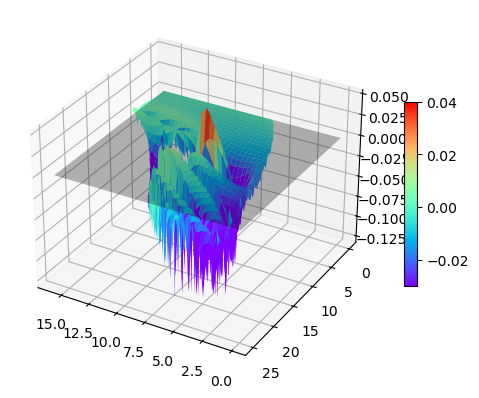

In [194]:
%matplotlib inline  
X, Y = np.meshgrid(ConcatenateVector_Iext_e,ConcatenateVector_eps)
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
surf = ax.plot_surface(X,Y,np.transpose(Floquet_2), cmap='rainbow',vmin=-0.03,vmax=0.04)
Z_plane = np.zeros_like(np.transpose(maxFloquet))  # Create a Z array of zeros with the same shape as the matrix
ax.plot_surface(X, Y, Z_plane, color='black', alpha=0.3)  # Red color and transparent
plt.gca().invert_xaxis()
plt.gca().invert_yaxis()
fig.colorbar(surf, ax=ax, shrink=0.5, aspect=15)

In [198]:
%matplotlib qt
X, Y = np.meshgrid(ConcatenateVector_Iext_e,ConcatenateVector_eps)
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
surf = ax.plot_surface(X,Y,np.transpose(Floquet_4), cmap='rainbow',vmin=-0.03,vmax=0.04)
Z_plane = np.zeros_like(np.transpose(maxFloquet))  # Create a Z array of zeros with the same shape as the matrix
ax.plot_surface(X, Y, Z_plane, color='black', alpha=0.3)  # Red color and transparent
plt.gca().invert_xaxis()
plt.gca().invert_yaxis()
fig.colorbar(surf, ax=ax, shrink=0.5, aspect=15)

In [157]:
%matplotlib qt
X, Y = np.meshgrid(ConcatenateVector_Iext_e,ConcatenateVector_eps)
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
surf = ax.plot_surface(X,Y,np.transpose(maxFloquet), cmap='rainbow',vmin=-0.03,vmax=0.04)
Z_plane = np.zeros_like(np.transpose(maxFloquet))  # Create a Z array of zeros with the same shape as the matrix
ax.plot_surface(X, Y, Z_plane, color='black', alpha=0.3)  # Red color and transparent
plt.gca().invert_xaxis()
plt.gca().invert_yaxis()
fig.colorbar(surf, ax=ax, shrink=0.5, aspect=15)


In [39]:
from scipy.interpolate import RegularGridInterpolator

In [101]:
maxFloquet.shape

(161, 251)

In [102]:
X.shape

(161, 251)

In [103]:
Y.shape

(161, 251)

In [173]:
masked_Floquet = maxFloquet
masked_Floquet.shape

(161, 251)

In [177]:
masked_Floquet[np.isnan(masked_Floquet)]=0

In [178]:
masked_Floquet.shape

(161, 251)

In [179]:
interp = RegularGridInterpolator((ConcatenateVector_Iext_e,ConcatenateVector_eps),masked_Floquet,method='cubic',)

In [116]:
eval = np.array([np.linspace(0,16,500), np.linspace(0,25,500)])

In [180]:
X,Y = np.meshgrid(np.linspace(0,16,10000), np.linspace(0,25,10000),indexing='ij')

In [181]:
eval.shape

(10000, 10000)

In [182]:
eval = interp((X,Y))

In [183]:
%matplotlib qt
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
surf = ax.plot_surface(X,Y,eval, cmap='rainbow',vmin=-0.03,vmax=0.04)
Z_plane = np.zeros_like(eval)  # Create a Z array of zeros with the same shape as the matrix
ax.plot_surface(X, Y, Z_plane, color='black', alpha=0.3)  # Red color and transparent
plt.gca().invert_xaxis()
plt.gca().invert_yaxis()
fig.colorbar(surf, ax=ax, shrink=0.5, aspect=15)

In [99]:
Y[:,0]

array([ 0. ,  0.1,  0.2,  0.3,  0.4,  0.5,  0.6,  0.7,  0.8,  0.9,  1. ,
        1.1,  1.2,  1.3,  1.4,  1.5,  1.6,  1.7,  1.8,  1.9,  2. ,  2.1,
        2.2,  2.3,  2.4,  2.5,  2.6,  2.7,  2.8,  2.9,  3. ,  3.1,  3.2,
        3.3,  3.4,  3.5,  3.6,  3.7,  3.8,  3.9,  4. ,  4.1,  4.2,  4.3,
        4.4,  4.5,  4.6,  4.7,  4.8,  4.9,  5. ,  5.1,  5.2,  5.3,  5.4,
        5.5,  5.6,  5.7,  5.8,  5.9,  6. ,  6.1,  6.2,  6.3,  6.4,  6.5,
        6.6,  6.7,  6.8,  6.9,  7. ,  7.1,  7.2,  7.3,  7.4,  7.5,  7.6,
        7.7,  7.8,  7.9,  8. ,  8.1,  8.2,  8.3,  8.4,  8.5,  8.6,  8.7,
        8.8,  8.9,  9. ,  9.1,  9.2,  9.3,  9.4,  9.5,  9.6,  9.7,  9.8,
        9.9, 10. , 10.1, 10.2, 10.3, 10.4, 10.5, 10.6, 10.7, 10.8, 10.9,
       11. , 11.1, 11.2, 11.3, 11.4, 11.5, 11.6, 11.7, 11.8, 11.9, 12. ,
       12.1, 12.2, 12.3, 12.4, 12.5, 12.6, 12.7, 12.8, 12.9, 13. , 13.1,
       13.2, 13.3, 13.4, 13.5, 13.6, 13.7, 13.8, 13.9, 14. , 14.1, 14.2,
       14.3, 14.4, 14.5, 14.6, 14.7, 14.8, 14.9, 15

In [68]:
plt.imshow(np.transpose(maxFloquet),cmap='rainbow', interpolation='nearest')
plt.gca().set_aspect('auto')
plt.gca().invert_yaxis()
cbar = plt.colorbar()

In [70]:
%matplotlib qt
X, Y = np.meshgrid(vector_eps,vector_Iext_e)
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.plot_surface(X,Y,maxFloquet, cmap='berlin',vmin=-0.02,vmax=0.02)
Z_plane = np.zeros_like(maxFloquet)  # Create a Z array of zeros with the same shape as the matrix
ax.plot_surface(X, Y, Z_plane, color='black', alpha=0.3)  # Red color and transparent
#ax.gca().invert_yaxis()
cbar = ax.colorbar()

RuntimeError: No mappable was found to use for colorbar creation. First define a mappable such as an image (with imshow) or a contour set (with contourf).